In [1]:
import os
import sys

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path+"/scripts")
    
import destruction_utilities as utils

/Users/arogyak/miniforge3/envs/destruction/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1dev-CAPI-1.14.1) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
CITY = "aleppo_cropped"
DATA_DIR = "../../data"
images  = utils.search_data(utils.pattern(city=CITY, type='image'), directory=DATA_DIR)

In [37]:
# image = images[7]
WINDOW_SIZE = (33,33)
TILE_SIZE = (128,128)
XOFFSET = 0
YOFFSET = 0
# XOFFSET = 75 # for 1
# YOFFSET = -50 # for 1
# XOFFSET = 75 # for 1
# YOFFSET = -50 # for 1

I = 13
print(images[I])
window = utils.center_window(images[I], (WINDOW_SIZE[0]*TILE_SIZE[0], WINDOW_SIZE[1]*TILE_SIZE[1]), TILE_SIZE, xoffset=XOFFSET, yoffset=YOFFSET)
image = utils.read_raster(images[7], window=window)

../../data/aleppo_cropped/images/image_2016_09_18.tif


In [38]:
import numpy as np
from skimage.feature import hog

def get_hog(image):
    image = np.float32(image)
    # image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    # image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY).astype(int)
    # return image
    # print(image.shape)
    _, image = hog(image, orientations=9, pixels_per_cell=(2,2),
                	cells_per_block=(4, 4), channel_axis=2, visualize=True)
    return image           

In [39]:
def normalize(image):
    return (image - np.min(image)) / (np.max(image) - np.min(image))

In [40]:
image_hog = normalize(get_hog(image))

NameError: name 'image_hog' is not defined

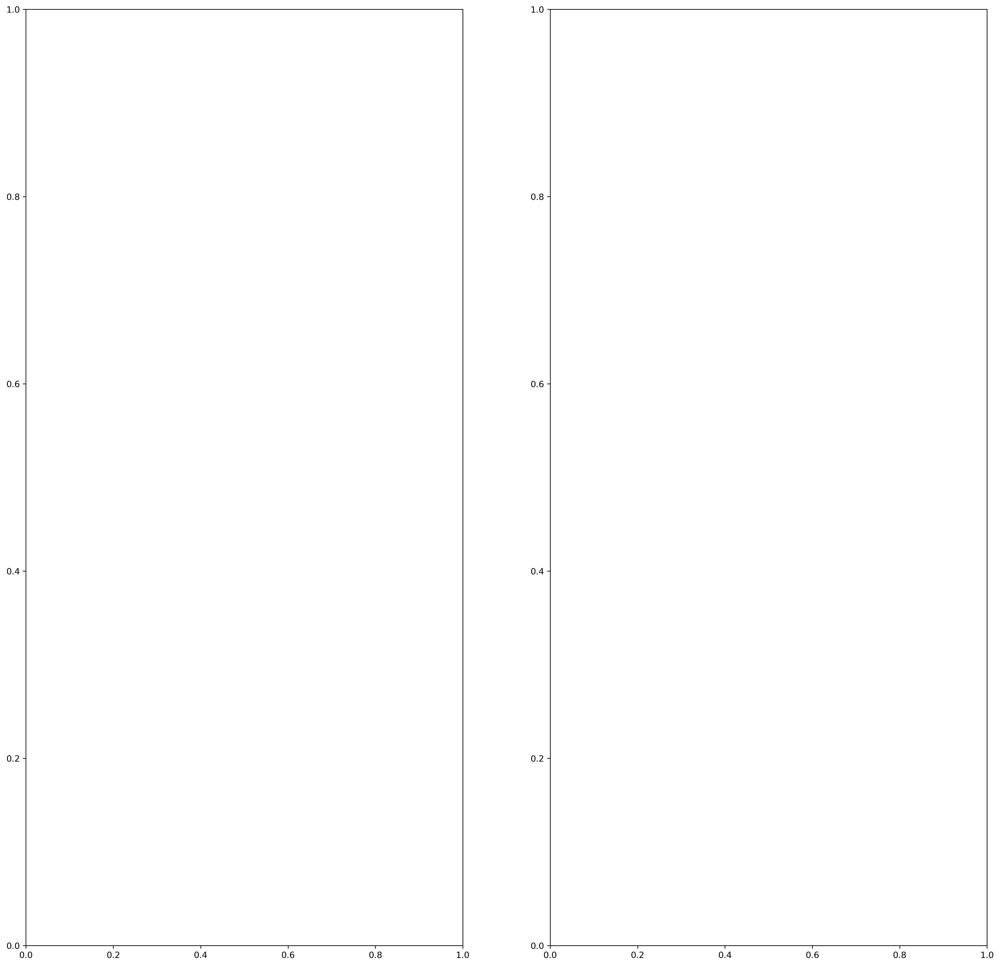

In [9]:
fig, ax = plt.subplots(1,2, figsize=(20,20), dpi=300)
ax = ax.flatten()
# image_hog = normalize(image_hog)

# ax.imshow(image[2300:3500, 3200:6000])
# ax.imshow(image_hog[2300:3500, 3200:6000])

# ax.imshow(image[2700:3100, 3200:4100])
ax[0].imshow(image_hog[:,:])
ax[1].imshow(image[:,:])

# ax[4].imshow(image[2300:3500, 3200:4100])
# ax[5].imshow(image_hog[2300:3500, 3200:4100])



# for axis in ax:
#     axis.set_axis_off()
# ax.set_axis('off')
plt.axis('off');
plt.tight_layout()


In [ ]:
3840*3840

In [2]:
import rasterio
with rasterio.open("../experiments/hogs/image_2013_05_26.tif") as src:
    a = src.read()

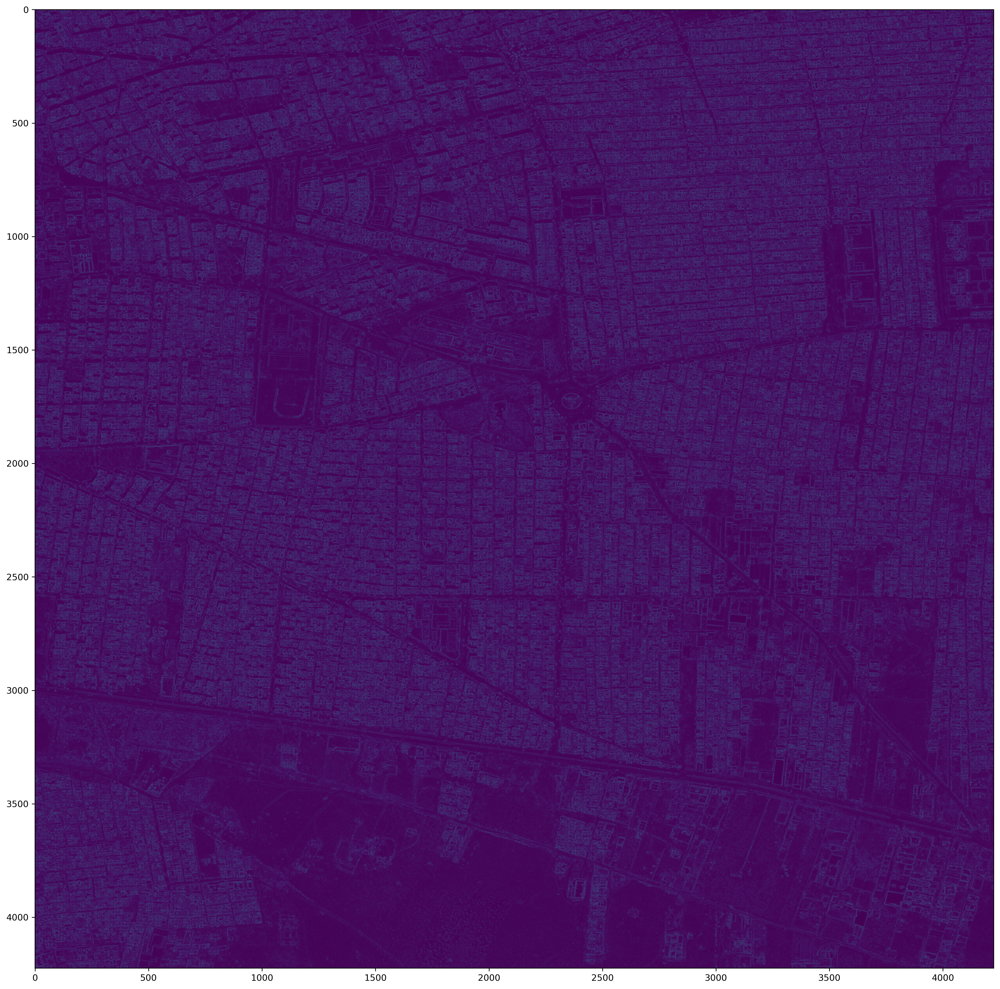

In [4]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1,1, figsize=(20,20), dpi=300)
# ax = ax.flatten()
ax.imshow(a.reshape((4224, 4224)))